In [109]:
import torch
from torch import nn, optim
import os
from torch.utils.data import DataLoader
from obddata import ObdData
from nets import AttentionBlk
import torch.nn.functional as F
import numpy as np
import csv
import time
import visdom
from tqdm import tqdm
import pandas as pd
import matplotlib.pyplot as plt
import osmnx as ox
import networkx as nx
import plotly.graph_objects as go
import psycopg2
import datetime
import plotly.io as pio
import osmnx as ox
from shapely.geometry import Polygon
import os
import gc
from os import walk
import geopandas as gpd
import plotly
from random import shuffle
import math

In [21]:
class GraphFactory:

    def __init__(self, g):
        self.graph = g

    def saveHmlTo(self, folderAddress):
        os.makedirs(folderAddress)
        ox.save_graphml(self.graph, filepath=os.path.join(folderAddress, 'osmGraph.graphml'))

    def graphToGdfs(self):
        nodes, edges = ox.graph_to_gdfs(self.graph, nodes=True, edges=True)
        return nodes, edges

    def getEdges(self):
        _, edges = self.graphToGdfs()
        return edges

    def getNodes(self):
        nodes, _ = self.graphToGdfs()
        return nodes

    def removeIsolateNodes(self):
        self.graph.remove_nodes_from(list(nx.isolates(self.graph)))

    def getNearestNode(self, yx):
        return ox.get_nearest_node(self.graph, yx, method='euclidean')

    def getODNodesFromODPair(self, odPair):
        origNode = self.getNearestNode(odPair.origin.yx())
        targetNode = self.getNearestNode(odPair.destination.yx())
        return origNode, targetNode

    def plotPath(self, path):
        fig, ax = ox.plot_graph_route(self.graph, path)

    def shortestPath(self, origNode, destNode):
        return nx.shortest_path(G=self.graph, source=origNode, target=destNode, weight='length')

    def ecoPath(self, origNode, destNode):

        '''
        numericalFeature = torch.randn(1, 3, 6)
        categoricalFeature = torch.randint(1, (1, 7, 3))
        estimationResult = estimationModel.predict(numericalFeature, categoricalFeature)
        '''
        self.origNode = origNode
        self.destNode = destNode
        self.estimationModel = EstimationModel("fuel")
        ecoPath, ecoEnergy = self.dijkstra()

    def fastestPath(self, origNode, destNode):
        self.origNode = origNode
        self.destNode = destNode
        self.estimationModel = EstimationModel("time")
        fastestPath, shortestTime = self.dijkstra()







class GraphFromHmlFile(GraphFactory):
    def __init__(self, hmlAddress):
        self.graph = ox.load_graphml(hmlAddress)


class GraphFromBbox(GraphFactory):
    def __init__(self, boundingBox):
        self.graph = ox.graph_from_polygon(boundingBox.polygon(), network_type='drive')


class GraphFromGdfs(GraphFactory):
    def __init__(self, nodes, edges):
        self.graph = ox.utils_graph.graph_from_gdfs(nodes, edges)

In [22]:
class Point:
    def __init__(self, x, y):
        self.x = x
        self.y = y
    def xy(self):
        return (self.x, self.y)
    def yx(self):
        return (self.y, self.x)


class OdPair:
    def __init__(self, origin, destination):
        self.origin = origin
        self.destination = destination


class Box:
    def __init__(self, lonMin, lonMax, latMin, latMax):
        self.lonMin = lonMin
        self.lonMax = lonMax
        self.latMin = latMin
        self.latMax = latMax

    def polygon(self):
        x1, x2, y1, y2 = self.lonMin, self.lonMax, self.latMin, self.latMax
        return Polygon([(x1, y1), (x2, y1), (x2, y2), (x1, y2)])



class LocationRequest:
    def __init__(self):
        # Murphy Depot
        #origin = Point(-93.2219, 44.979)
        origin = Point(-93.2466, 44.8959)
        # Shakopee East (Depot):
        #destination = Point(-93.4620, 44.7903)
        #destination = Point(-93.4301, 44.8640)
        destination = Point(-93.4495, 44.8611)

        self.odPair = OdPair(origin, destination)
        self.boundingBox = Box(-93.4975, -93.1850, 44.7458, 45.0045)

In [24]:

def extractGraphOf(boundingBox):
    folderOfGraph = r'GraphDataInBbox'
    if os.path.exists(folderOfGraph):
        print("reloading graph..")
        osmGraph = GraphFromHmlFile(os.path.join(folderOfGraph, 'osmGraph.graphml'))
    else:
        print("downloading graph..")
        osmGraph = GraphFromBbox(boundingBox)
        osmGraph.saveHmlTo(folderOfGraph)
    #fig, ax = ox.plot_graph(osmGraph)
    return osmGraph


def extractGraphInMurphy(osmGraph):
    nodes, edges = osmGraph.graphToGdfs()
    edgesInMurphy = extractEdgesInMurphy(edges)
    graphInMurphy = GraphFromGdfs(nodes, edgesInMurphy)
    return graphInMurphy


def extractEdgesInMurphy(edges):
    edges['uvPair'] = edges.apply(lambda x: (x.u, x.v), axis=1)
    segmentElevationChange = np.load('segmentElevationChange.npy', allow_pickle=True).item()
    edges['isInMurphy'] = edges.uvPair.apply(lambda x: x in segmentElevationChange)
    return edges[edges.isInMurphy]


def findShortestPath(osmGraph, odPair):
    origNode, targetNode = osmGraph.getODNodesFromODPair(odPair)
    shortestPath = osmGraph.shortestPath(origNode,targetNode)
    osmGraph.plotPath(shortestPath)
    return shortestPath


def findEcoPathAndCalEnergy(osmGraph, odPair):
    origNode, targetNode = osmGraph.getODNodesFromODPair(odPair)
    ecoPath, ecoEnergy = osmGraph.ecoPath(origNode,targetNode)
    osmGraph.plotPath(ecoPath)
    return ecoPath, ecoEnergy


def findFastestPathAndCalTime(osmGraph, odPair):
    origNode, targetNode = osmGraph.getODNodesFromODPair(odPair)
    fastestPath, shortestTime = osmGraph.fastestPath(origNode,targetNode)
    osmGraph.plotPath(fastestPath)
    return fastestPath, shortestTime

In [25]:
locationRequest = LocationRequest()
osmGraphInBbox = extractGraphOf(locationRequest.boundingBox)
graphInMurphy = extractGraphInMurphy(osmGraphInBbox)
graphInMurphy.removeIsolateNodes()

reloading graph..


In [32]:
origNode, targetNode = graphInMurphy.getODNodesFromODPair(locationRequest.odPair)

In [38]:
targetNode

33800315

In [26]:
nodes =  graphInMurphy.getNodes()

In [117]:
nodes

,y,x,osmid,geometry,highway,ref
33295092,44.990086,-93.355080,33295092,POINT (-93.35508 44.99009),NaN,NaN
33295130,45.003671,-93.380322,33295130,POINT (-93.38032 45.00367),NaN,NaN
33296345,44.987912,-93.219025,33296345,POINT (-93.21903 44.98791),NaN,NaN
33296377,44.989737,-93.217725,33296377,POINT (-93.21773 44.98974),NaN,NaN
33296390,44.991543,-93.217690,33296390,POINT (-93.21769 44.99154),traffic_signals,NaN
...,...,...,...,...,...,...
7173719659,44.961980,-93.189493,7173719659,POINT (-93.18949 44.96198),NaN,NaN
7301246350,44.996559,-93.461622,7301246350,POINT (-93.46162 44.99656),traffic_signals,NaN
7301246351,44.996711,-93.461618,7301246351,POINT (-93.46162 44.99671),traffic_signals,NaN
8146751356,44.793849,-93.465569,8146751356,POINT (-93.46557 44.79385),NaN,NaN


In [209]:
edges = graphInMurphy.getEdges()

In [210]:
edges.head()

,osmid,name,highway,oneway,length,geometry,uvPair,isInMurphy,ref,maxspeed,lanes,bridge,access,tunnel,junction,u,v,key
0,6019978,Lindsay Street,residential,False,431.292,"LINESTRING (-93.35508 44.99009, -93.35423 44.9...","(33295092, 33363060)",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295092,33363060,0
1,6031937,Zane Avenue North,tertiary,False,288.377,"LINESTRING (-93.35508 44.99009, -93.35515 44.9...","(33295092, 33800025)",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295092,33800025,0
2,6031937,Zane Avenue North,tertiary,False,566.785,"LINESTRING (-93.35508 44.99009, -93.35509 44.9...","(33295092, 33369219)",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295092,33369219,0
3,22903893,Winnetka Avenue North,tertiary,False,203.598,"LINESTRING (-93.38032 45.00367, -93.38032 45.0...","(33295130, 33371979)",True,CR 156,NaN,NaN,NaN,NaN,NaN,NaN,33295130,33371979,0
4,202302913,Southeast Como Avenue,tertiary,False,100.269,"LINESTRING (-93.21903 44.98791, -93.21839 44.9...","(33296345, 33296589)",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33296345,33296589,0


In [161]:
edges['uSignal'] = edges.u.apply(lambda x: nodes.loc[x, 'highway']).fillna("None")
edges['vSignal'] = edges.v.apply(lambda x: nodes.loc[x, 'highway']).fillna("None")

In [162]:
endpoints_dictionary = np.load('endpoints_dictionary.npy', allow_pickle=True).item()
endpoints_dictionary

{'None': 0,
 'turning_circle': 1,
 'traffic_signals': 2,
 'turning_loop': 3,
 'motorway_junction': 4,
 'crossing': 5,
 'stop': 6,
 'bus_stop': 7,
 'mini_roundabout': 8,
 'rest_area': 9,
 'motorway_link': 10,
 'turning_circle;crossing': 11,
 'residential': 12,
 'traffic_signals;crossing': 13,
 'traffic_signals;bus_stop': 14,
 'priority': 15,
 'give_way': 16}

In [163]:
edges

,osmid,name,highway,oneway,length,geometry,uvPair,isInMurphy,ref,maxspeed,lanes,bridge,access,tunnel,junction,u,v,key,uSignal,vSignal
0,6019978,Lindsay Street,residential,False,431.292,"LINESTRING (-93.35508 44.99009, -93.35423 44.9...","(33295092, 33363060)",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295092,33363060,0,None,None
1,6031937,Zane Avenue North,tertiary,False,288.377,"LINESTRING (-93.35508 44.99009, -93.35515 44.9...","(33295092, 33800025)",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295092,33800025,0,None,None
2,6031937,Zane Avenue North,tertiary,False,566.785,"LINESTRING (-93.35508 44.99009, -93.35509 44.9...","(33295092, 33369219)",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295092,33369219,0,None,None
3,22903893,Winnetka Avenue North,tertiary,False,203.598,"LINESTRING (-93.38032 45.00367, -93.38032 45.0...","(33295130, 33371979)",True,CR 156,NaN,NaN,NaN,NaN,NaN,NaN,33295130,33371979,0,None,None
4,202302913,Southeast Como Avenue,tertiary,False,100.269,"LINESTRING (-93.21903 44.98791, -93.21839 44.9...","(33296345, 33296589)",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33296345,33296589,0,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2469,18237140,Valley Industrial Boulevard South,tertiary,False,108.204,"LINESTRING (-93.46557 44.79385, -93.46642 44.7...","(8146751356, 188063558)",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8146751356,188063558,0,None,None
2470,18237140,Valley Industrial Boulevard South,tertiary,False,1177.662,"LINESTRING (-93.46557 44.79385, -93.46528 44.7...","(8146751356, 188038056)",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8146751356,188038056,0,None,None
2471,875233783,NaN,residential,False,116.778,"LINESTRING (-93.46557 44.79385, -93.46567 44.7...","(8146751356, 8146751361)",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8146751356,8146751361,0,None,None
2472,18236749,Valley Industrial Circle South,residential,False,187.948,"LINESTRING (-93.46688 44.79372, -93.46687 44.7...","(8146751361, 188063559)",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8146751361,188063559,0,None,turning_circle


In [164]:
edges['uSignal-d'] = edges.uSignal.apply(lambda x: endpoints_dictionary[x] if x in endpoints_dictionary else 0)
edges['vSignal-d'] = edges.vSignal.apply(lambda x: endpoints_dictionary[x] if x in endpoints_dictionary else 0)

In [182]:
def cal_lanes(array_like):
    if isinstance(array_like['lanes'],list):
        for i in array_like['lanes']:
            if i.isdecimal():
                return int(i)
    if pd.isna(array_like['lanes']):
        return 0
    if array_like['lanes'].isalpha():
        return 0
    if array_like['lanes'].isalnum():
        return int(array_like['lanes']) if int(array_like['lanes']) > 0 else 0
    else:
        return 0

In [183]:
edges['lanes'] = edges.apply(lambda x: cal_lanes(x), axis=1)
edges['lanes'] = edges['lanes'].apply(lambda x: x if x <= 8 else 8)

In [186]:
segmentElevationChange = np.load('segmentElevationChange.npy', allow_pickle=True).item()
edges['elevationChange'] = edges.apply(lambda x: segmentElevationChange[(x.u, x.v)], axis=1)

In [188]:
edges['mass'] = 23000

In [191]:
def calTimeStage(timeOfTheDay):
    return timeOfTheDay // 4 + 1    
edges['timeOfTheDay'] = 9
edges['timeOfTheDay'] = edges.timeOfTheDay.apply(lambda x: calTimeStage(x))

In [204]:
def calSpeedlimit(edge):
    if isinstance(edge['maxspeed'],float):
        if math.isnan(edge['maxspeed']):
            if edge['highway'] == "motorway":
                return 55 * 1.609
            elif edge['highway'] == "motorway_link":
                return 50 * 1.609
            return 30 * 1.609
        else:
            return edge['maxspeed'] * 1.609
    else:
        res = ''
        flag = 0
        for i in list(edge['maxspeed']):
            if i.isdigit():
                flag = 1
                res += i
            else:
                if flag == 1:
                    speed = int(res) * 1.609
                    return speed
edges['speedLimit'] = edges.apply(lambda x: calSpeedlimit(x), axis=1)

In [216]:
def highway_cal(network_seg):
    '''Calcuate the road type of an edge ('unclassified' in default)

    Args:
        Attributes of an edge
    
    Returns:
        Road type of the edge 
    '''
    if 'highway' in network_seg and network_seg['highway']:
        if isinstance(network_seg['highway'], str):
            return network_seg['highway']
        elif isinstance(network_seg['highway'], list):
            return network_seg['highway'][0]
    else:
        return 'unclassified'
edges['roadtype'] = edges.apply(lambda x: highway_cal(x), axis=1)

In [217]:
roadtypeDict = np.load('road_type_dictionary.npy', allow_pickle=True).item()
edges['roadtype'] = edges.roadtype.apply(lambda x: roadtypeDict[x] if x in roadtypeDict else 0)

In [229]:
a = edges.loc[0,'geometry']

In [251]:
def pointsInSegment(geometry):
    pointsStringList = list(str(geometry)[12: -1].split(", "))
    for i,val in enumerate(pointsStringList):
        pointsStringList[i] = tuple(map(float, val.split(" ")))
    return pointsStringList

In [252]:
edges['points'] = edges.geometry.apply(lambda x: pointsInSegment(x))

In [257]:
edges.loc[0,'points'][-1]

(-93.3499078, 44.9895309)

In [265]:
def directionAngle(pointsList):
    longitude_o, latitude_o = pointsList[0]
    longitude_d, latitude_d = pointsList[-1]
    direction = [latitude_d - latitude_o, longitude_d - longitude_o]
    direction_array = np.array(direction)
    cosangle = direction_array.dot(np.array([1, 0])) / (np.linalg.norm(direction_array))
    if np.cross(direction_array, np.array([1, 0])) < 0:
        direction_angle = math.acos(cosangle) * 180 / np.pi
    else:
        direction_angle = -math.acos(cosangle) * 180 / np.pi
    return direction_angle

In [266]:
edges['directionAngle'] = edges.points.apply(lambda x: directionAngle(x))

In [268]:
edges.bridge

0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
       ... 
2469    NaN
2470    NaN
2471    NaN
2472    NaN
2473    NaN
Name: bridge, Length: 2474, dtype: object

In [ ]:
def bridgeOrNot(bridge):
    if isinstance(bridge,float):
        return 0
    else:
        print(bridge)
        return 1

In [244]:
a_list = list(str(a)[12: -1].split(", "))

In [245]:
str(a)

'LINESTRING (-93.35508 44.990086, -93.3542329 44.9900794, -93.35410280000001 44.9900784, -93.35388020000001 44.9900767, -93.3532763 44.990072, -93.35302 44.99007, -93.35204299999999 44.990059, -93.35186 44.990047, -93.351692 44.990013, -93.35153200000001 44.989948, -93.35140199999999 44.989864, -93.35129499999999 44.989761, -93.35111999999999 44.989582, -93.351074 44.989548, -93.35101299999999 44.989529, -93.35095200000001 44.989521, -93.3499078 44.9895309)'

In [246]:
for i,val in enumerate(a_list):
    a_list[i] = tuple(map(float, val.split(" ")))
a_list

[(-93.35508, 44.990086),
 (-93.3542329, 44.9900794),
 (-93.3541028, 44.9900784),
 (-93.3538802, 44.9900767),
 (-93.3532763, 44.990072),
 (-93.35302, 44.99007),
 (-93.352043, 44.990059),
 (-93.35186, 44.990047),
 (-93.351692, 44.990013),
 (-93.351532, 44.989948),
 (-93.351402, 44.989864),
 (-93.351295, 44.989761),
 (-93.35112, 44.989582),
 (-93.351074, 44.989548),
 (-93.351013, 44.989529),
 (-93.350952, 44.989521),
 (-93.3499078, 44.9895309)]

In [225]:
edges.bridge.fillna(None)

ValueError: Must specify a fill 'value' or 'method'.

In [224]:
edges.loc[1616]

osmid                 [22738831, 639492585, 42865378, 53344919]
name                                                        NaN
highway                                                      20
oneway                                                     True
length                                                  409.973
geometry      LINESTRING (-93.4005543 44.9695778, -93.400554...
uvPair                                   (536282601, 536282600)
isInMurphy                                                 True
ref                                                      US 169
maxspeed                                                 60 mph
lanes                                                         2
bridge                                         [undefined, yes]
access                                                      NaN
tunnel                                                      NaN
junction                                                    NaN
u                                       

In [138]:
e['signal_u'] = nodes.loc[e['u'], 'highway']
e['signal_v'] = nodes.loc[e['v'], 'highway']

<ipython-input-138-0f9da235800d>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  e['signal_u'] = nodes.loc[e['u'], 'highway']
<ipython-input-138-0f9da235800d>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  e['signal_v'] = nodes.loc[e['v'], 'highway']
C:\Users\mingzhou\Anaconda3\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [139]:
math.isnan(e['signal_u'])

True

In [140]:
e

osmid                                                   6019978
name                                             Lindsay Street
highway                                             residential
oneway                                                    False
length                                                  431.292
geometry      LINESTRING (-93.35508 44.990086, -93.3542329 4...
uvPair                                     (33295092, 33363060)
isInMurphy                                                 True
ref                                                         NaN
maxspeed                                                    NaN
lanes                                                       NaN
bridge                                                      NaN
access                                                      NaN
tunnel                                                      NaN
junction                                                    NaN
u                                       

In [51]:
nodesSet = set(nodes.index)

In [111]:
class Test:
    def __init__(self):
        self.val = self.calval(1,2)
    def calval(self,m,n):
        return m+n

In [113]:
a = Test()

In [114]:
a.val


3

In [115]:
a = []
b = []
for i in a:
    b.append(1)
b

[]

In [52]:
import copy
passedNodes = set([origNode])
notPassedNodes = copy.deepcopy(nodesSet)
notPassedNodes.remove(origNode)

In [ ]:
while targetNode not in passedNodes:
    

In [59]:
def findEdgeFrom(node):
    edgesFromNode = edges[edges['u']==node]
    return edgesFromNode

In [60]:
edgesFromNode = findEdgeFrom(origNode)

In [61]:
edgesFromNode

,osmid,name,highway,oneway,length,geometry,uvPair,isInMurphy,ref,maxspeed,lanes,bridge,access,tunnel,junction,u,v,key
1208,35082137,Crosstown Highway,motorway,True,68.554,"LINESTRING (-93.24678 44.89582, -93.24762 44.8...","(411566530, 411566531)",True,MN 62,NaN,2,yes,NaN,NaN,NaN,411566530,411566531,0


In [76]:
def extractEdgeFeature(edge, nodes):
    return ([edge['length'],3.4],[0,0,0])

In [78]:
def calval(nextNode,prevEdgeFeature,curEdgeFeature):
    return 32423

In [ ]:
edgeFeatureDictionary = dict()
valueOfNodes = dict()
prevEdgeOfNode = dict()
curNode = origNode
prevEdgeFeatureOfNode[curNode] = -1
valueOfNodes[curNode] = 0

In [100]:

for edgeIdInGdf in list(edgesFromNode.index):
    nextNode = edgesFromNode.loc[edgeIdInGdf,'v']
    if edgeIdInGdf in edgeFeatureDictionary:
        curEdgeFeature = edgeFeatureDictionary[edgeIdInGdf]
    else:
        curEdgeFeature = extractEdgeFeature(edgesFromNode.loc[edgeIdInGdf], nodes) 
        edgeFeatureDictionary[edgeIdInGdf] = curEdgeFeature
    value = calval(nextNode,prevEdgeFeatureOfNode[curNode],curEdgeFeature)
    if nextNode not in valueOfNodes or valueOfNodes[curNode] + value < valueOfNode[nextNode]:
        print("yes")
        valueOfNodes[nextNode] = valueOfNodes[curNode] + value
        prevEdgeOfNode[nextNode] = edgeIdInGdf
    else:
        print("no")

yes


In [108]:
edges[edges['u']==1001589119]

,osmid,name,highway,oneway,length,geometry,uvPair,isInMurphy,ref,maxspeed,lanes,bridge,access,tunnel,junction,u,v,key
2039,86291327,NaN,motorway_link,True,183.518,"LINESTRING (-93.27182 44.89074, -93.27282 44.8...","(1001589119, 1001588829)",True,NaN,NaN,2,NaN,NaN,NaN,NaN,1001589119,1001588829,0
2040,"[86291304, 86291315, 86291334]",Crosstown Highway,motorway,True,725.101,"LINESTRING (-93.27182 44.89074, -93.27244 44.8...","(1001589119, 1001588927)",True,MN 62,NaN,2,yes,NaN,NaN,NaN,1001589119,1001588927,0


In [105]:
edgesFromNode

,osmid,name,highway,oneway,length,geometry,uvPair,isInMurphy,ref,maxspeed,lanes,bridge,access,tunnel,junction,u,v,key
1209,640656831,Crosstown Highway,motorway,True,352.121,"LINESTRING (-93.24762 44.89566, -93.24943 44.8...","(411566531, 411567904)",True,MN 62,55 mph,2,NaN,NaN,NaN,NaN,411566531,411567904,0


In [101]:
edgeFeatureDictionary

{1208: ([68.554, 3.4], [0, 0, 0])}

In [102]:
valueOfNodes

{411566530: 0, 411566531: 32423}

In [103]:
prevEdgeFeatureOfNode

{411566530: -1, 411566531: 1208}

In [53]:
passedNodes

{411566530}

In [54]:
len(notPassedNodes)

1858

In [55]:
len(nodesSet)

1859

In [39]:
targetNode in nodesSet

True

In [17]:
class EstimationModel:
    featureDim = 6
    embeddingDim = [4, 2, 2, 2, 2, 4, 4]
    numOfHeads = 1
    outputDimension = 1
    def __init__(self):
        print(self.numOfHeads)

In [19]:
a = EstimationModel()

1


In [15]:
b = GraphFromHmlFile(1)
b.graph

3

In [16]:
b.test()

5

In [6]:
g.graph

(1, 2)

In [2]:
class Box:
    def __init__(self, lonMin, lonMax, latMin, latMax):
        self.lonMin = lonMin
        self.lonMax = lonMax
        self.latMin = latMin
        self.latMax = latMax

    def polygon(self):
        x1, x2, y1, y2 = self.lonMin, self.lonMax, self.latMin, self.latMax
        return Polygon([(x1, y1), (x2, y1), (x2, y2), (x1, y2)])

In [3]:
#boundingBox = Box(-93.4696,-93.4219, 44.7854, 44.89)

In [3]:
g_loaded = ox.load_graphml('GraphDataInBbox/osmGraph.graphml')

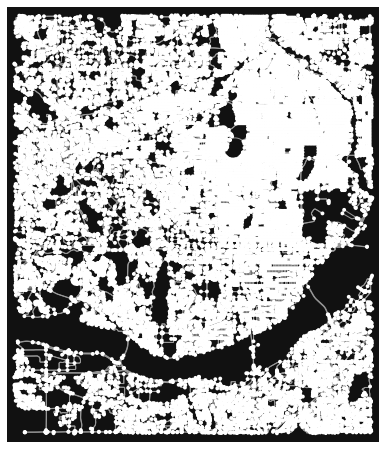

In [5]:
fig, ax = ox.plot_graph(g_loaded)

In [4]:
nodes_loaded, edges_loaded = ox.graph_to_gdfs(g_loaded, nodes=True, edges=True)

In [5]:
nodes_loaded

,y,x,osmid,highway,ref,geometry
33295049,44.925143,-93.265072,33295049,NaN,NaN,POINT (-93.26507 44.92514)
33295062,44.980513,-93.358550,33295062,NaN,NaN,POINT (-93.35855 44.98051)
33295067,44.980893,-93.358120,33295067,NaN,NaN,POINT (-93.35812 44.98089)
33295073,44.925143,-93.266334,33295073,NaN,NaN,POINT (-93.26633 44.92514)
33295086,44.923332,-93.265099,33295086,NaN,NaN,POINT (-93.26510 44.92333)
...,...,...,...,...,...,...
8685576120,44.865415,-93.303586,8685576120,NaN,NaN,POINT (-93.30359 44.86541)
8685576194,44.862835,-93.302357,8685576194,NaN,NaN,POINT (-93.30236 44.86283)
8685735001,44.883374,-93.280962,8685735001,NaN,NaN,POINT (-93.28096 44.88337)
8695473339,44.909927,-93.304868,8695473339,NaN,NaN,POINT (-93.30487 44.90993)


In [6]:
edges_loaded

,osmid,name,highway,maxspeed,oneway,length,geometry,ref,lanes,bridge,tunnel,access,junction,area,service,u,v,key
0,6022209,East 43rd Street,residential,30 mph,False,100.067,"LINESTRING (-93.26507 44.92514, -93.26492 44.9...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295049,33369407,0
1,6022209,East 43rd Street,residential,30 mph,False,99.358,"LINESTRING (-93.26507 44.92514, -93.26522 44.9...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295049,33295073,0
2,6034404,Park Avenue South,secondary,30 mph,True,201.309,"LINESTRING (-93.26507 44.92514, -93.26507 44.9...",CR 33,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295049,33369328,0
3,6020303,Paisley Lane,residential,NaN,False,55.610,"LINESTRING (-93.35855 44.98051, -93.35854 44.9...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295062,33295067,0
4,6020303,Paisley Lane,residential,NaN,False,209.642,"LINESTRING (-93.35855 44.98051, -93.35852 44.9...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295062,33738925,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69423,"[700590206, 700589895]",West 66th Street,secondary,NaN,True,202.545,"LINESTRING (-93.28096 44.88337, -93.27997 44.8...",CR 53,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8685735001,6579154951,0
69424,6015959,Morgan Avenue South,residential,NaN,False,131.346,"LINESTRING (-93.30487 44.90993, -93.30486 44.9...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8695473339,33371897,0
69425,798189915,Wooddale Avenue South,tertiary,NaN,False,10.001,"LINESTRING (-93.34425 44.92655, -93.34418 44.9...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8707920786,33370856,0
69426,"[41413956, 6027030]","[Raleigh Avenue South, West 42nd Street]",residential,NaN,False,243.333,"LINESTRING (-93.34425 44.92655, -93.34417 44.9...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8707920786,34512205,0


In [7]:
orig_xy = (44.979, -93.2219)
orig_node = ox.get_nearest_node(g_loaded, orig_xy, method='euclidean')
orig_node

301297715

In [8]:
target_xy = (44.7903, -93.4620)
target_node = ox.get_nearest_node(g_loaded, target_xy, method='euclidean')
target_node

8146751356

In [11]:
o_closest = nodes_loaded.loc[orig_node]
t_closest = nodes_loaded.loc[target_node]

In [12]:
od_nodes = gpd.GeoDataFrame([o_closest, t_closest], geometry='geometry', crs=nodes_loaded.crs)
od_nodes.head()

,y,x,osmid,highway,ref,geometry
301297715,44.977982,-93.220654,301297715,NaN,NaN,POINT (-93.22065 44.97798)
8146751356,44.793849,-93.465569,8146751356,NaN,NaN,POINT (-93.46557 44.79385)


In [13]:
# Calculate the shortest path
route = nx.shortest_path(G=g_loaded, source=orig_node, target=target_node, weight='length')

# Show what we have
print(route)

[301297715, 244110319, 34638990, 301295780, 33749238, 1674139069, 1641850667, 244111192, 1025799475, 1817826566, 33419919, 598048989, 598260853, 598260880, 598037615, 598037808, 33741160, 33465717, 34561215, 596664549, 596664559, 595906980, 595898782, 595955534, 595839400, 6928916280, 595819785, 595434003, 245812803, 740355099, 33308314, 476913479, 476914885, 33382792, 476914946, 34509163, 476916370, 34383306, 33750688, 34392416, 34397391, 34397632, 34188179, 34163786, 33464056, 33296901, 33316298, 33316299, 1355644211, 430586497, 34638790, 2939829463, 414212637, 476944911, 476944926, 476948454, 476948459, 6960948421, 678979183, 729441988, 729441987, 729441984, 561037952, 678980591, 678980588, 699924126, 6141477756, 678254900, 678254898, 678254896, 33457336, 678254893, 2472823034, 678254891, 678254888, 700682568, 700682567, 678254885, 33318883, 8227916672, 8493346868, 560964732, 678254883, 560655152, 564231574, 568935618, 593993693, 593993698, 700682565, 593993564, 595487079, 34173817,

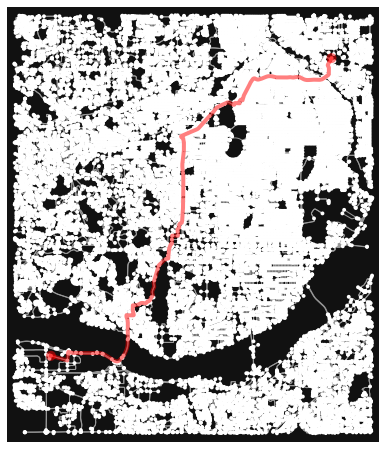

In [14]:
# Plot the shortest path
fig, ax = ox.plot_graph_route(g_loaded, route)

In [9]:
segmentsElevation = np.load('segmentElevationChange.npy', allow_pickle=True).item()

In [11]:
edges_loaded['uvPair']  = edges_loaded.apply(lambda x: (x.u, x.v), axis=1)

In [12]:
edges_loaded

,osmid,name,highway,maxspeed,oneway,length,geometry,ref,lanes,bridge,tunnel,access,junction,area,service,u,v,key,uvPair
0,6022209,East 43rd Street,residential,30 mph,False,100.067,"LINESTRING (-93.26507 44.92514, -93.26492 44.9...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295049,33369407,0,"(33295049, 33369407)"
1,6022209,East 43rd Street,residential,30 mph,False,99.358,"LINESTRING (-93.26507 44.92514, -93.26522 44.9...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295049,33295073,0,"(33295049, 33295073)"
2,6034404,Park Avenue South,secondary,30 mph,True,201.309,"LINESTRING (-93.26507 44.92514, -93.26507 44.9...",CR 33,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295049,33369328,0,"(33295049, 33369328)"
3,6020303,Paisley Lane,residential,NaN,False,55.610,"LINESTRING (-93.35855 44.98051, -93.35854 44.9...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295062,33295067,0,"(33295062, 33295067)"
4,6020303,Paisley Lane,residential,NaN,False,209.642,"LINESTRING (-93.35855 44.98051, -93.35852 44.9...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33295062,33738925,0,"(33295062, 33738925)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69423,"[700590206, 700589895]",West 66th Street,secondary,NaN,True,202.545,"LINESTRING (-93.28096 44.88337, -93.27997 44.8...",CR 53,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8685735001,6579154951,0,"(8685735001, 6579154951)"
69424,6015959,Morgan Avenue South,residential,NaN,False,131.346,"LINESTRING (-93.30487 44.90993, -93.30486 44.9...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8695473339,33371897,0,"(8695473339, 33371897)"
69425,798189915,Wooddale Avenue South,tertiary,NaN,False,10.001,"LINESTRING (-93.34425 44.92655, -93.34418 44.9...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8707920786,33370856,0,"(8707920786, 33370856)"
69426,"[41413956, 6027030]","[Raleigh Avenue South, West 42nd Street]",residential,NaN,False,243.333,"LINESTRING (-93.34425 44.92655, -93.34417 44.9...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8707920786,34512205,0,"(8707920786, 34512205)"


In [13]:
edges_loaded['isInMurphy'] = edges_loaded.uvPair.apply(lambda x: x in segmentsElevation)

In [14]:
edgesInMurphy = edges_loaded[edges_loaded.isInMurphy]

In [15]:
GInMurph = ox.utils_graph.graph_from_gdfs(nodes_loaded,edgesInMurphy)

In [16]:
GInMurph.remove_nodes_from(list(nx.isolates(GInMurph)))

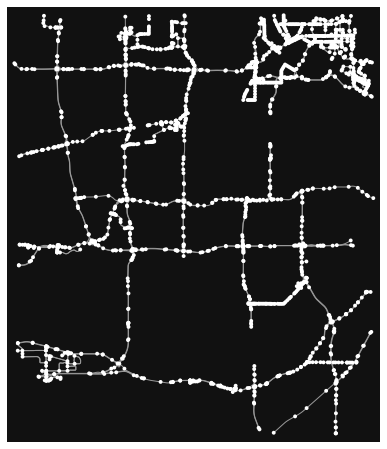

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)

In [17]:
ox.plot_graph(GInMurph)

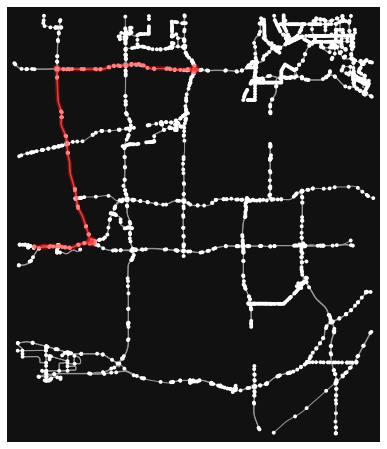

In [18]:
orig_xy = (44.9711, -93.3393)
#orig_xy = (44.979, -93.2219)
orig_node = ox.get_nearest_node(GInMurph, orig_xy, method='euclidean')
target_xy = (44.8640, -93.4301)
#target_xy = (44.7903, -93.4620)?
target_node = ox.get_nearest_node(GInMurph, target_xy, method='euclidean')
route = nx.shortest_path(G=GInMurph, source=orig_node, target=target_node, weight='length')
fig, ax = ox.plot_graph_route(GInMurph, route)

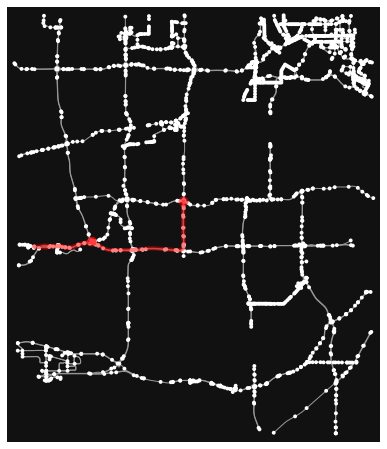

In [20]:
orig_xy = (44.8896, -93.3503)
#orig_xy = (44.979, -93.2219)
orig_node = ox.get_nearest_node(GInMurph, orig_xy, method='euclidean')
target_xy = (44.8640, -93.4301)
#target_xy = (44.7903, -93.4620)?
target_node = ox.get_nearest_node(GInMurph, target_xy, method='euclidean')
route = nx.shortest_path(G=GInMurph, source=orig_node, target=target_node, weight='length')
fig, ax = ox.plot_graph_route(GInMurph, route)

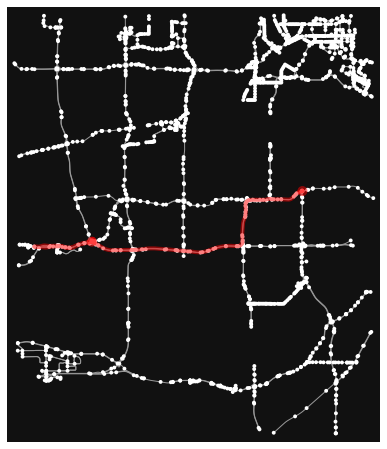

In [23]:
orig_xy = (44.8959, -93.2466)
#orig_xy = (44.979, -93.2219)?
orig_node = ox.get_nearest_node(GInMurph, orig_xy, method='euclidean')
target_xy = (44.8640, -93.4301)
#target_xy = (44.7903, -93.4620)?
target_node = ox.get_nearest_node(GInMurph, target_xy, method='euclidean')
route = nx.shortest_path(G=GInMurph, source=orig_node, target=target_node, weight='length')
fig, ax = ox.plot_graph_route(GInMurph, route)

In [26]:
orig_xy = (44.8912, -93.2969)
#orig_xy = (44.979, -93.2219)?
orig_node = ox.get_nearest_node(GInMurph, orig_xy, method='euclidean')
target_xy = (44.8402,-93.2437)
#target_xy = (44.7903, -93.4620)?
target_node = ox.get_nearest_node(GInMurph, target_xy, method='euclidean')
route = nx.shortest_path(G=GInMurph, source=orig_node, target=target_node, weight='length')
fig, ax = ox.plot_graph_route(GInMurph, route)

NetworkXNoPath: No path to 247963907.

In [49]:
# Calculate the shortest path
route = nx.shortest_path(G=GInMurph, source=orig_node, target=target_node, weight='length')

# Show what we have
print(route)

[245483610, 557602941, 558552784, 558552794, 558552937, 34537590, 34165573, 565204609, 565204583, 536282753, 540508714, 540508713, 536282800, 536282816, 536282817, 540499565, 536282828, 536282831, 540489959, 540489256, 633736828, 633736824, 540489199, 415166451, 415166453, 580985203, 567723289, 580982973, 580983924, 633736820, 633736809, 415166930, 299173907, 415166933, 34668315, 33800315, 117871219, 1831608935, 34163068, 475384052, 731711193, 474694191, 1686002710, 474694141, 471569261, 499578545, 499578647, 499466899]


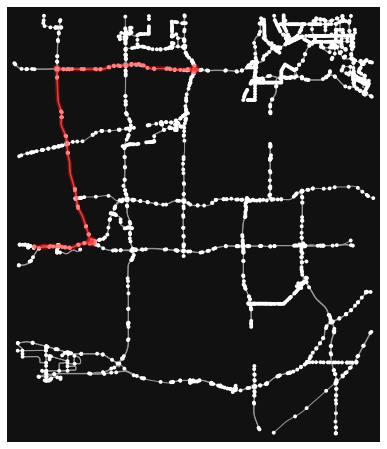

In [51]:
#orig_xy = (44.9711, -93.3393)
#target_xy = (44.8640, -93.4301)
fig, ax = ox.plot_graph_route(GInMurph, route)

In [24]:
edges_loaded[edges_loaded['osmid'] in segmentsElevation]

TypeError: 'Series' objects are mutable, thus they cannot be hashed

In [15]:
ox.elevation.add_node_elevations(g_loaded,api_key="api.open-elevation.com/api/v1/lookup")

UnboundLocalError: local variable 'response' referenced before assignment

In [29]:
def extractSegmentsFromBbox(boundingBox):
    pathOfGraphFolder = r'GraphDataInBbox'
    if os.path.exists(pathOfGraphFolder):
        print("reloading network..")
        graphInBbox = reloadGraphFrom(pathOfGraphFolder)
    else:
        print("downloading network..")
        graphInBbox = downloadGraphTo(pathOfGraphFolder, boundingBox)
    fig, ax = ox.plot_graph(graphInBbox)
    nodes, edges = ox.graph_to_gdfs(g_loaded, nodes=True, edges=True)
    print(nodes.head())
    print(edges.head())
    orig_node = ox.get_nearest_node(g_loaded, (44.786, -93.44), method='euclidean')
    print(orig_node)


def reloadGraphFrom(pathOfGraphFolder):
    return ox.load_graphml(os.path.join(pathOfGraphFolder, 'graph.graphml'))


def downloadGraphTo(pathOfGraphFolder, boundingBox):
    os.makedirs(pathOfGraphFolder)
    g = ox.graph_from_polygon(boundingBox.polygon(), network_type='drive')
    ox.save_graphml(g, filepath=os.path.join(pathOfGraphFolder, 'graph.graphml'))
    return g

reloading network..


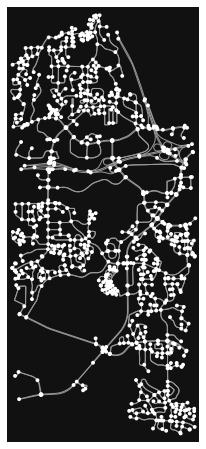

                  y          x     osmid highway  ref  \
33295354  44.872223 -93.458916  33295354     NaN  NaN   
33295379  44.871548 -93.458115  33295379     NaN  NaN   
33295381  44.871433 -93.458229  33295381     NaN  NaN   
33295400  44.871971 -93.458397  33295400     NaN  NaN   
33295426  44.872215 -93.457909  33295426     NaN  NaN   

                            geometry  
33295354  POINT (-93.45892 44.87222)  
33295379  POINT (-93.45812 44.87155)  
33295381  POINT (-93.45823 44.87143)  
33295400  POINT (-93.45840 44.87197)  
33295426  POINT (-93.45791 44.87221)  
     osmid             name      highway  oneway  length  \
0  6034293    Bedford Drive  residential   False  14.060   
1  6014077  Penny Hill Road  residential   False  69.505   
2  6034293    Bedford Drive  residential   False  43.518   
3  5998604       Amber Lane  residential   False  15.658   
4  6034293    Bedford Drive  residential   False  53.246   

                                            geometry  ref maxs

In [30]:
extractSegmentsFromBbox(boundingBox)